# Imports

In [21]:
# ALL
import csv
import cv2
import json
import math
import os
import PIL
import requests
import sys

# AS
import cv2 as cv
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# FROM
from io import BytesIO
from osgeo import gdal
from PIL import Image, ImageOps, ImageChops, ImageDraw, ImageFont
from skimage import exposure
from tabulate import tabulate

# Data Preperation

In [22]:
date_list = ['04_11_21',
'14_09_21',
'14_09_22',
'15_07_22',
'25_05_22',
'27_07_21']

In [23]:
# Set the working directory
base_dir = "/Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach"
date = date_list[0]
date_dir = os.path.join(base_dir, date)

### Step 1: Load and Process Tree Mapping Data

In [24]:
# Load the Tree Mapping Excel file
tree_mapping_path = os.path.join(base_dir, "Tree Mapping.xlsx")
tree_mapping_excel_file = pd.ExcelFile(tree_mapping_path)

# Load the Tree Mapping Excel file into a DataFrame
tree_mapping_df = pd.read_excel(tree_mapping_path, header=None)

# Load each sheet in the Excel file into its own DataFrame
tree_mapping_dfs = {sheet: pd.read_excel(tree_mapping_excel_file, sheet_name=sheet) for sheet in tree_mapping_excel_file.sheet_names}

In [25]:
# Display the first few rows of the dataframe to understand its structure
tree_mapping_df.head()

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,1.0,1.0,1.0,1.0,1,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
1,2.0,2.0,2.0,2.0,2,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
2,3.0,3.0,3.0,3.0,3,3.0,3.0,3.0,3.0,3.0,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
3,4.0,4.0,4.0,4.0,4,4.0,4.0,4.0,4.0,4.0,...,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0
4,5.0,5.0,5.0,5.0,5,5.0,5.0,5.0,5.0,5.0,...,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,NaN,5.0


In [26]:
# Display the first few rows of each DataFrame to understand its structure
for sheet, df in tree_mapping_dfs.items():
    print(f"Sheet name: {sheet}")
    print(tabulate(df.head(), headers='keys', tablefmt='pretty'))
    print("\n")

Sheet name: 27_07_21
+---+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+
|   |  1  | 1.1 | 1.2 | 1.3 | 1.4 | 1.5 | 1.6 | 1.7 | 1.8 | 1.9 | 1.10 | 1.11 | 1.12 | 1.13 | 1.14 | 1.15 | 1.16 | 1.17 | 1.18 | 1.19 | 1.20 | 1.21 | 1.22 | 1.23 | 1.24 | 1.25 | 1.26 | 1.27 | 1.28 | 1.29 |
+---+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+------+
| 0 | 2.0 | 2.0 | 2.0 | 2.0 |  2  | 2.0 | 2.0 | 2.0 | 2.0 | 2.0 | 2.0  |  2   |  2   |  2   |  2   |  2   |  2   |  2   |  2   |  2   | 2.0  | 2.0  | 2.0  | 2.0  | 2.0  | 2.0  | 2.0  | 2.0  | 2.0  | 2.0  |
| 1 | 3.0 | 3.0 | 3.0 | 3.0 |  3  | 3.0 | 3.0 | 3.0 | 3.0 | 3.0 | 3.0  |  3   |  3   |  3   |  3   |  3   |  3   |  3   |  3   |  3   | 3.0  | 3.0  | 3.0  

In [27]:
# Load the Label Excel file
label_path = os.path.join(date_dir, f"{date}.csv")
label_df = pd.read_csv(label_path, header=None,names=['Tree_ID', 'Label'])

# Display the first few rows of the dataframe to understand its structure
label_df.head()

,Tree_ID,Label
0,1-1,0
1,1-2,0
2,1-3,0
3,1-4,0
4,1-5,0


### Step 2: Load Image Metadata

In [28]:
# Define directories for the images
aerial_uav_dir = os.path.join(date_dir, "Aerial_UAV_Photos")
ground_rgb_dir = os.path.join(date_dir, "Ground_RGB_Photos")
ground_rgb_bounding_box_dir = os.path.join(date_dir, "Ground_RGB_Photos_bounding_box")
ground_multispectral_dir = os.path.join(date_dir, "Ground_Multispectral_Photos")
ground_multispectral_bounding_box_dir = os.path.join(date_dir, "Ground_Multispectral_Photos_bounding_box")

In [29]:
# Load the provided NDVI images
ndvi_data_path = os.path.join(aerial_uav_dir, "NDVI.data.tif") #"/mnt/data/NDVI.data.jpeg"
ndvi_rgb_path = os.path.join(aerial_uav_dir, "NDVI.rgb.tif") #"/mnt/data/NDVI.rgb.jpeg"

# Load the NDVI images using OpenCV
ndvi_data_image = cv2.imread(ndvi_data_path, cv2.IMREAD_UNCHANGED)
ndvi_rgb_image = cv2.imread(ndvi_rgb_path, cv2.IMREAD_UNCHANGED)

In [30]:
# Paths to the uploaded image files
aerial_uav_images_file_paths = {
    "green_data": os.path.join(aerial_uav_dir, 'green.data.tif'), 
    "green_rgb": os.path.join(aerial_uav_dir, 'green.rgb.tif'), 
    "ndvi_data": os.path.join(aerial_uav_dir, 'NDVI.data.tif'), 
    "ndvi_rgb": os.path.join(aerial_uav_dir, 'NDVI.rgb.tif'), 
    "nir_data": os.path.join(aerial_uav_dir, 'nir.data.tif'), 
    "nir_rgb": os.path.join(aerial_uav_dir, 'nir.rgb.tif'), 
    "red_data": os.path.join(aerial_uav_dir, 'red.data.tif'), 
    "red_rgb": os.path.join(aerial_uav_dir, 'red.rgb.tif'), 
    "rededge_data": os.path.join(aerial_uav_dir, 'rededge.data.tif'), 
    "rededge_rgb": os.path.join(aerial_uav_dir, 'rededge.rgb.tif'),
    # "orthomosaic_data": os.path.join(aerial_uav_dir, 'Orthomosaic.data.tif'),
    "orthomosaic_rgb": os.path.join(aerial_uav_dir, 'Orthomosaic.rgb.tif'),
    "orthomosaic": os.path.join(aerial_uav_dir, 'Orthomosaic.tif')
}

In [31]:
# Show sample structure of the directories in depth
def list_directories(path, current_depth=0):
    image_extensions = {'.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.TIF', '.json'}
    try:
        entries = os.listdir(path)
    except PermissionError:
        return

    for entry in entries:
        full_path = os.path.join(path, entry)
        if os.path.isdir(full_path):
            print(f"{' ' * (current_depth * 2)}{entry}/")
            list_directories(full_path, current_depth + 1)
        else:
            _, ext = os.path.splitext(entry)
            if ext.lower() in image_extensions:
                print(f"{' ' * (current_depth * 2)}{entry} (image file)")
                return
            else:
                print(f"{' ' * (current_depth * 2)}{entry}")

In [32]:
# Display the first 2 levels of the directories
print("UAV Directory:")
list_directories(aerial_uav_dir)
print("\nRGB Directory:")
list_directories(ground_rgb_dir)
print("\nRGB Bounding Box Directory:")
list_directories(ground_rgb_bounding_box_dir)
print("\nMultispectral Directory:")
list_directories(ground_multispectral_dir)

UAV Directory:
NDVI_RGB.png (image file)

RGB Directory:
Healthy/
  25-15.jpg (image file)
Dead Trees/
  3-26.jpg (image file)
Grapholita molesta/
  6-29.jpg (image file)
Anarsia lineatella/
  4-13.jpg (image file)

RGB Bounding Box Directory:
.DS_Store
Healthy/
  9-10_annotated.svg
  6-9_annotated.svg
  9-9.json (image file)
Dead Trees/
  3-26.png (image file)
Grapholita molesta/
  15-19.json (image file)
Anarsia lineatella/
  4-13.png (image file)

Multispectral Directory:
.DS_Store
Healthy/
  10 - 30/
    sequoia_diag.dat
    ndre_image_315.jpeg (image file)
  7 - 2/
    sequoia_diag.dat
    IMG_700101_000116_0000_RGB.JPG (image file)
  17 - 25/
    IMG_700101_001822_0000_REG.TIF
    ndre_image_553.jpeg (image file)
  13 - 20/
    IMG_700101_004307_0000_RGB.JPG (image file)
  17 - 22/
    savi_image_550.jpeg (image file)
  7 - 5/
    sequoia_diag.dat
    IMG_700101_000146_0000_NIR.TIF
    IMG_700101_000146_0000_REG.TIF
    ndre_image_191.jpeg (image file)
  16 - 8/
    IMG_700101_00

In [33]:
# Function to load image filenames
def load_image_and_annotations_filenames(directory, extension=None):
    file_list = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith(extension):
                file_list.append(os.path.join(root, file))
    return file_list

In [34]:
# Load the image filenames
aerial_uav_images = load_image_and_annotations_filenames(aerial_uav_dir, ('.jpg', '.tif', '.TIF', '.png', '.gif', '.bmp', '.jpeg'))
ground_rgb_dir = load_image_and_annotations_filenames(ground_rgb_dir, ('.jpg', '.tif', '.TIF', '.png', '.gif', '.bmp', '.jpeg'))
rgb_bounding_box_images = load_image_and_annotations_filenames(ground_rgb_bounding_box_dir, ('.jpg', '.tif', '.TIF', '.png', '.gif', '.bmp', '.jpeg'))
rgb_bounding_box_annotations = load_image_and_annotations_filenames(ground_rgb_bounding_box_dir, '.json')
# multispectral_ground_rgb_dir = load_image_and_annotations_filenames(ground_multispectral_dir)

In [35]:
# Display the number of images in each category
print(f"UAV images: {len(aerial_uav_images)}")
print(f"RGB images: {len(ground_rgb_dir)}")
print(f"RGB bounding box images: {len(rgb_bounding_box_images)}")
print(f"RGB bounding box annotations: {len(rgb_bounding_box_annotations)}")
# print(f"Multispectral images: {len(multispectral_ground_rgb_dir)}")

UAV images: 14
RGB images: 887
RGB bounding box images: 64
RGB bounding box annotations: 64


In [36]:
# Function to load specific multispectral image filenames (IMG_700101_XXXXXX_XXXX_RGB.JPG)
def load_multispectral_filenames(directory, sufix):
    file_list = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.startswith('IMG_') and file.endswith(sufix):
                file_list.append(os.path.join(root, file))
    return file_list

In [37]:
# Display the multispectral images
multispectral_ground_rgb_images = load_multispectral_filenames(ground_multispectral_dir, 'RGB.JPG')
print(f"Multispectral RGB images: {len(multispectral_ground_rgb_images)}")
multispectral_reg_images = load_multispectral_filenames(ground_multispectral_dir, 'REG.TIF')
print(f"Multispectral REG images: {len(multispectral_reg_images)}")
multispectral_red_images = load_multispectral_filenames(ground_multispectral_dir, 'RED.TIF')
print(f"Multispectral RED images: {len(multispectral_red_images)}")
multispectral_nir_images = load_multispectral_filenames(ground_multispectral_dir, 'NIR.TIF')
print(f"Multispectral NIR images: {len(multispectral_nir_images)}")
multispectral_gre_images = load_multispectral_filenames(ground_multispectral_dir, 'GRE.TIF')
print(f"Multispectral GRE images: {len(multispectral_gre_images)}")
multispectral_ground_rgb_bounding_box_images =  load_multispectral_filenames(ground_multispectral_bounding_box_dir, '.png')
print(f"Multispectral RGB Bounding Box images: {len(multispectral_gre_images)}")
multispectral_ground_rgb_bounding_box_annotations =  load_multispectral_filenames(ground_multispectral_bounding_box_dir, '.json')
print(f"Multispectral RGB Bounding Box annotations: {len(multispectral_gre_images)}")

Multispectral RGB images: 885
Multispectral REG images: 885
Multispectral RED images: 885
Multispectral NIR images: 885
Multispectral GRE images: 885
Multispectral RGB Bounding Box images: 885
Multispectral RGB Bounding Box annotations: 885


### Step 3: Link Images Using Tree Mapping

In [38]:
# Function to extract tree ID from filename
def extract_tree_id(filename):
    base_name = os.path.basename(filename)
    parts = base_name.split('_')
    
    # Check if filename follows '3-26.jpg' pattern
    if '-' in base_name:
        return base_name.split('.')[0]
    # Check if filename follows 'IMG_700101_000146_0000_RGB.JPG' pattern
    elif len(parts) >= 3:
        # Extract tree ID from the directory structure, assuming the pattern is '7 - 2/IMG_700101_000116_0000_RGB.JPG'
        parent_dir = os.path.basename(os.path.dirname(filename))
        if ' - ' in parent_dir:
            return parent_dir.replace(' ', '')
        return parts[1] + '-' + parts[2]
    else:
        return None  # Return None if the pattern does not match

In [39]:
# Create dictionaries to link images to tree IDs

# uav_dict = {extract_tree_id(img): img for img in aerial_uav_images if extract_tree_id(img) is not None}

ground_rgb_dict = {extract_tree_id(img): img for img in ground_rgb_dir if extract_tree_id(img) is not None}
ground_rgb_bounding_box_images_dict = {extract_tree_id(img): img for img in rgb_bounding_box_images if extract_tree_id(img) is not None}
ground_rgb_bounding_box_annotations_dict = {extract_tree_id(img): img for img in rgb_bounding_box_annotations if extract_tree_id(img) is not None}


multispectral_rgb_dict = {extract_tree_id(img): img for img in multispectral_ground_rgb_images if extract_tree_id(img) is not None}
multispectral_reg_dict = {extract_tree_id(img): img for img in multispectral_reg_images if extract_tree_id(img) is not None}
multispectral_red_dict = {extract_tree_id(img): img for img in multispectral_red_images if extract_tree_id(img) is not None}
multispectral_nir_dict = {extract_tree_id(img): img for img in multispectral_nir_images if extract_tree_id(img) is not None}
multispectral_gre_dict = {extract_tree_id(img): img for img in multispectral_gre_images if extract_tree_id(img) is not None}
multispectral_rgb_bounding_box_images_dict = {extract_tree_id(img): img for img in multispectral_ground_rgb_bounding_box_images if extract_tree_id(img) is not None}
multispectral_ground_rgb_bounding_box_annotations = {extract_tree_id(img): img for img in multispectral_ground_rgb_bounding_box_annotations if extract_tree_id(img) is not None}


In [40]:
# Example linking for a specific tree ID
tree_id = '7-11'

uav_image = os.path.join(aerial_uav_dir, "NDVI.rgb.tif")

ground_rgb_image = ground_rgb_dict.get(tree_id)
ground_rgb_bounding_box_image = ground_rgb_bounding_box_images_dict.get(tree_id)
ground_rgb_bounding_box_annotation = ground_rgb_bounding_box_annotations_dict.get(tree_id)

multispectral_rgb_image = multispectral_rgb_dict.get(tree_id)
multispectral_reg_image = multispectral_reg_dict.get(tree_id)
multispectral_red_image = multispectral_red_dict.get(tree_id)
multispectral_nir_image = multispectral_nir_dict.get(tree_id)
multispectral_gre_image = multispectral_gre_dict.get(tree_id)
multispectral_rgb_bounding_box_image = multispectral_rgb_bounding_box_images_dict.get(tree_id)
multispectral_rgb_bounding_box_annotation= multispectral_ground_rgb_bounding_box_annotations.get(tree_id)

print(f"Tree {tree_id}:")
print(f"        UAV: {uav_image}")
print(f"        RGB: {ground_rgb_image}")
print(f"        RGB Bounding Box: {ground_rgb_bounding_box_image}")
print(f"        RGB Bounding Box Annotation: {ground_rgb_bounding_box_annotation}")
print(f"        Multispectral RGB: {multispectral_rgb_image}")
print(f"        Multispectral REG: {multispectral_reg_image}")
print(f"        Multispectral RED: {multispectral_red_image}")
print(f"        Multispectral NIR: {multispectral_nir_image}")
print(f"        Multispectral GRE: {multispectral_gre_image}")
print(f"        Multispectral Bounding Box: {multispectral_rgb_bounding_box_image}")
print(f"        Multispectral Bounding Box Annotation: {multispectral_rgb_bounding_box_annotation}")

Tree 7-11:
        UAV: /Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach/04_11_21/Aerial_UAV_Photos/NDVI.rgb.tif
        RGB: /Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach/04_11_21/Ground_RGB_Photos/Healthy/7-11.jpg
        RGB Bounding Box: /Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach/04_11_21/Ground_RGB_Photos_bounding_box/Healthy/7-11.png
        RGB Bounding Box Annotation: /Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach/04_11_21/Ground_RGB_Photos_bounding_box/Healthy/7-11.json
        Multispectral RGB: /Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach/04_11_21/Ground_Multispectral_Photos/Healthy/7 - 11/IMG_700101_000248_0000_RGB.JPG
        Multispectral REG: /Users/izzymohamed/Desktop/Vision For Social Good/Project/Vision-For-Social-Good/DATA/Peach/04_11_21/Gro

### Step 5: 

In [41]:
# Define the health status colors
status_colors = {
    0: 'green',   # Healthy
    1: 'blue',    # Grapholita molesta
    2: 'red',     # Anarsia lineatella
    3: 'black'    # Dead Trees
}

# Define the health status colors
status_colors_rgb = {
    0: (0, 255, 0),     # Green for Healthy
    1: (0, 0, 255),     # Blue for Grapholita molesta
    2: (255, 0, 0),     # Red for Anarsia lineatella
    3: (0, 0, 0)        # Black for Dead Trees
}

In [42]:
# Define a function to create a status grid from the CSV data
def create_status_grid(df):
    max_row = 0
    max_col = 0
    status_dict = {}
    
    for index, row in df.iterrows():
        tree_id, status = row[0], row[1]
        row_idx, col_idx = map(int, tree_id.split('-'))
        status_dict[(row_idx, col_idx)] = status
        max_row = max(max_row, row_idx)
        max_col = max(max_col, col_idx)
    
    status_grid = np.full((max_row, max_col), np.nan)
    for (row_idx, col_idx), status in status_dict.items():
        status_grid[row_idx-1, col_idx-1] = status
    
    return status_grid

In [43]:
# Create the status grid from the CSV data
status_grid = create_status_grid(label_df)

/var/folders/qd/ds8njzhn1zv9q727vvvr8h0m0000gn/T/ipykernel_2181/2017960110.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  tree_id, status = row[0], row[1]


In [44]:
# Define a function to plot the orchard mapping from the status grid
def plot_orchard_from_grid(status_grid, title, output_folder):
    fig, ax = plt.subplots(figsize=(12, 12))
    for i in range(status_grid.shape[0]):
        for j in range(status_grid.shape[1]):
            status = status_grid[i, j]
            if not np.isnan(status):
                color = status_colors.get(int(status), 'gray')
                circle = plt.Circle((j, -i), 0.4, color=color, edgecolor='black')
                ax.add_patch(circle)
    ax.set_xlim(-1, status_grid.shape[1])
    ax.set_ylim(-status_grid.shape[0], 1)
    ax.set_aspect('equal')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(title)
    plt.gca().invert_yaxis()
    plt.savefig(os.path.join(output_folder, f"{title}.png"))
    plt.show()

In [45]:
# Define a function to save the orchard plot without any colors
def plot_orchard_no_color(df, title, filename):
    fig, ax = plt.subplots(figsize=(12, 12))
    for i, row in df.iterrows():
        for j, status in enumerate(row):
            try:
                status = float(status)
                if not np.isnan(status):
                    circle = plt.Circle((j, -i), 0.4, edgecolor='black', facecolor='none')
                    ax.add_patch(circle)
            except ValueError:
                pass
    ax.set_xlim(-1, df.shape[1])
    ax.set_ylim(-df.shape[0], 1)
    ax.set_aspect('equal')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(title)
    plt.gca().invert_yaxis()
    plt.savefig(filename)
    plt.close()

In [46]:
# Define the annotation file path
orchard_mapping_file_path = os.path.join(base_dir, '04_11_21', 'Orchard_Mapping') # '/mnt/data/tree_annotations.txt'

/var/folders/qd/ds8njzhn1zv9q727vvvr8h0m0000gn/T/ipykernel_2181/2290415208.py:9: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle((j, -i), 0.4, color=color, edgecolor='black')


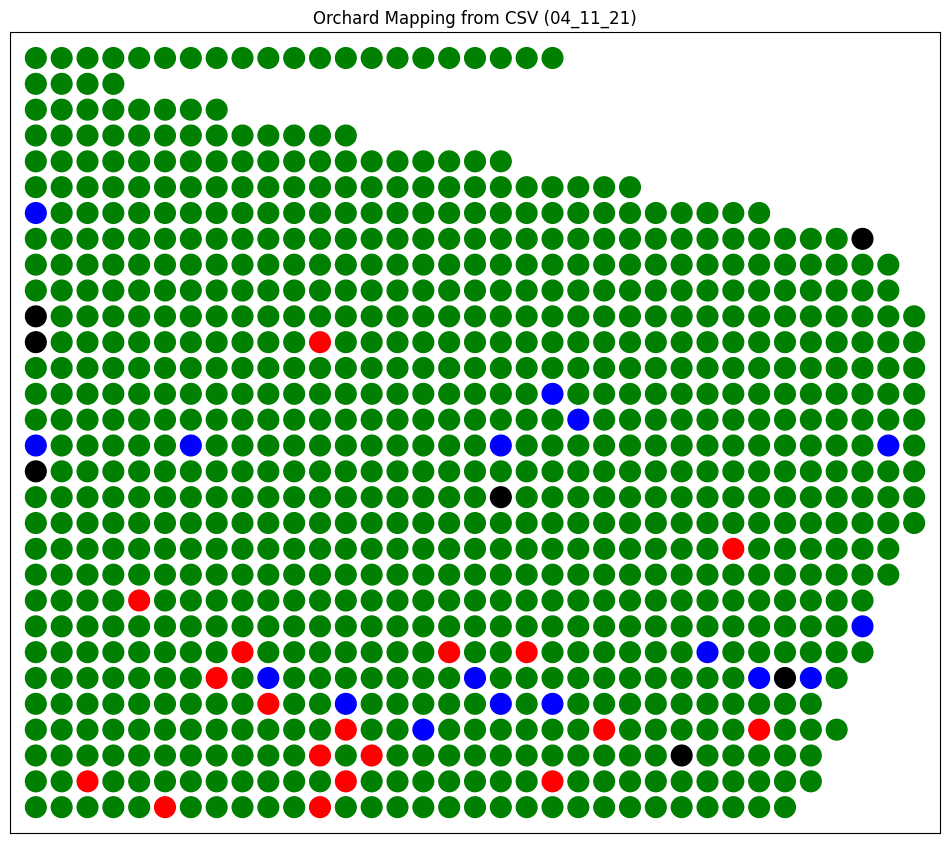

In [47]:
# Plot the orchard mapping for the status grid from the CSV data
plot_orchard_from_grid(status_grid, 'Orchard Mapping from CSV (04_11_21)', orchard_mapping_file_path)

### Step 4: Create a Multimodal Dataset

In [48]:
# Define the paths to the annotation files
orchard_mapping_annotation_csv_path = os.path.join(orchard_mapping_file_path, 'tree_annotations.csv') # '/mnt/data/Orchard_Mapping/tree_annotations.csv'
orchard_mapping_image_path = os.path.join(orchard_mapping_file_path, 'Orchard Mapping from CSV (04_11_21).png') # '/mnt/data/Orchard_Mapping/Orchard Mapping from CSV (04_11_21).png'

In [49]:
# Read the annotation CSV file to get normalized coordinates and radius
orchard_mapping_annotation_df = pd.read_csv(orchard_mapping_annotation_csv_path)

In [50]:
# Create a DataFrame to store the multimodal dataset
data = []
for row_index, row in label_df.iterrows():
    tree_id = row['Tree_ID']
    label = row['Label']
    
    # Assuming we have dictionaries for image paths (you can replace these with your actual dictionaries)
    date = date
    orchard_mapping_image = orchard_mapping_image_path

    uav_image = uav_image # uav_image_dict.get(tree_id, None)  # Assuming UAV image paths are stored similarly

    ground_rgb_image = ground_rgb_dict.get(tree_id, None)
    ground_rgb_bounding_box_image = ground_rgb_bounding_box_images_dict.get(tree_id, None)
    ground_rgb_bounding_box_annotation = ground_rgb_bounding_box_annotations_dict.get(tree_id, None)

    multispectral_rgb_image = multispectral_rgb_dict.get(tree_id, None)
    multispectral_reg_image = multispectral_reg_dict.get(tree_id, None)
    multispectral_red_image = multispectral_red_dict.get(tree_id, None)
    multispectral_nir_image = multispectral_nir_dict.get(tree_id, None)
    multispectral_gre_image = multispectral_gre_dict.get(tree_id, None)
    multispectral_rgb_bounding_box_image = multispectral_rgb_bounding_box_images_dict.get(tree_id, None)
    multispectral_rgb_bounding_box_annotation= multispectral_ground_rgb_bounding_box_annotations.get(tree_id, None)
    
    data.append([date, tree_id, orchard_mapping_image, uav_image, ground_rgb_image, ground_rgb_bounding_box_image, ground_rgb_bounding_box_annotation, multispectral_rgb_image, multispectral_reg_image, multispectral_red_image, multispectral_nir_image, multispectral_gre_image, multispectral_rgb_bounding_box_image, multispectral_rgb_bounding_box_annotation, label])

In [51]:
# Create the multimodal DataFrame
multimodal_df = pd.DataFrame(data, columns=['Date','Tree_ID', 'Orchard_Mapping_Image', 'Aerial_UAV_Image', 'Ground_RGB_Image', 'Ground_RGB_Image_with_Bounding_Boxes', 'Ground_RGB_Image_Annotations', 'Multispectral_RGB_Image', 'Multispectral_REG_Image', 'Multispectral_RED_Image', 'Multispectral_NIR_Image', 'Multispectral_GRE_Image', 'Multispectral_RGB_Bounding_Box_Image', 'Multispectral_RGB_Bounding_Box_Annotation', 'Label'])

In [52]:
# Display the first few rows of the DataFrame
multimodal_df.head()

,Date,Tree_ID,Orchard_Mapping_Image,Aerial_UAV_Image,Ground_RGB_Image,Ground_RGB_Image_with_Bounding_Boxes,Ground_RGB_Image_Annotations,Multispectral_RGB_Image,Multispectral_REG_Image,Multispectral_RED_Image,Multispectral_NIR_Image,Multispectral_GRE_Image,Multispectral_RGB_Bounding_Box_Image,Multispectral_RGB_Bounding_Box_Annotation,Label
0,04_11_21,1-1,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,0
1,04_11_21,1-2,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,0
2,04_11_21,1-3,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,0
3,04_11_21,1-4,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,0
4,04_11_21,1-5,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,0


### Step 6: Checking Location

In [53]:
# Function to plot the image with annotations
def plot_image_with_annotations(image_path, json_path, fig_size=(30, 30)):
    # Load the image
    image = Image.open(image_path)
    
    # Load the JSON data
    with open(json_path, 'r') as f:
        named_data = json.load(f)
    
    # Plot the image
    fig, ax = plt.subplots(figsize=fig_size)
    ax.imshow(image)
    ax.axis('off')  # Hide the axis

    # Plot the rectangles and labels
    for region in named_data['regions']:
        x0, x1 = region['points']['x']
        y0, y1 = region['points']['y']
        rect = patches.Rectangle((x0, y0), x1 - x0, y1 - y0, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        
        label = region['name'] if region['name'] else region['name_old']
        color = "black" if region['name'] == "" else "white"
        bbox_props = dict(facecolor='white', alpha=1) if region['name'] == "" else dict(facecolor='black', alpha=0.5)
        
        ax.text(x0, y0, label, fontsize=16, color=color, verticalalignment='top', bbox=bbox_props)

    # Show the plot
    plt.show()

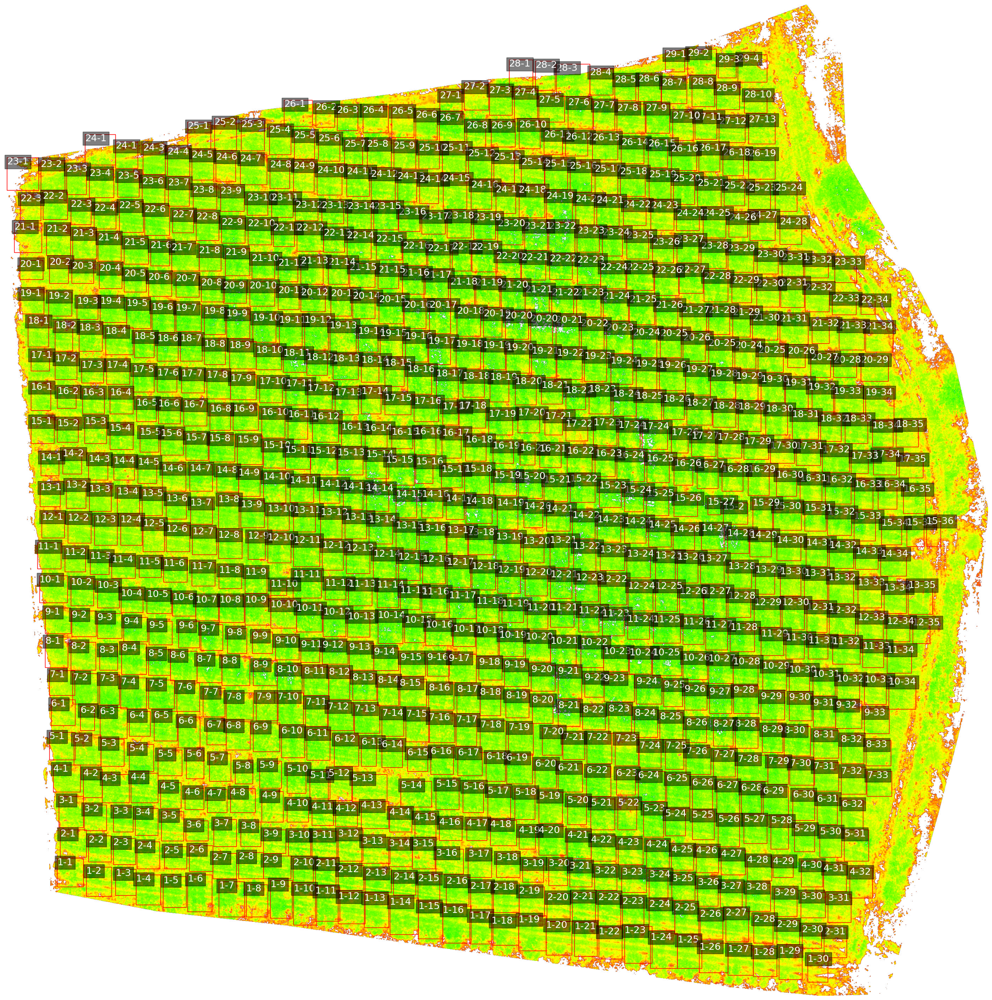

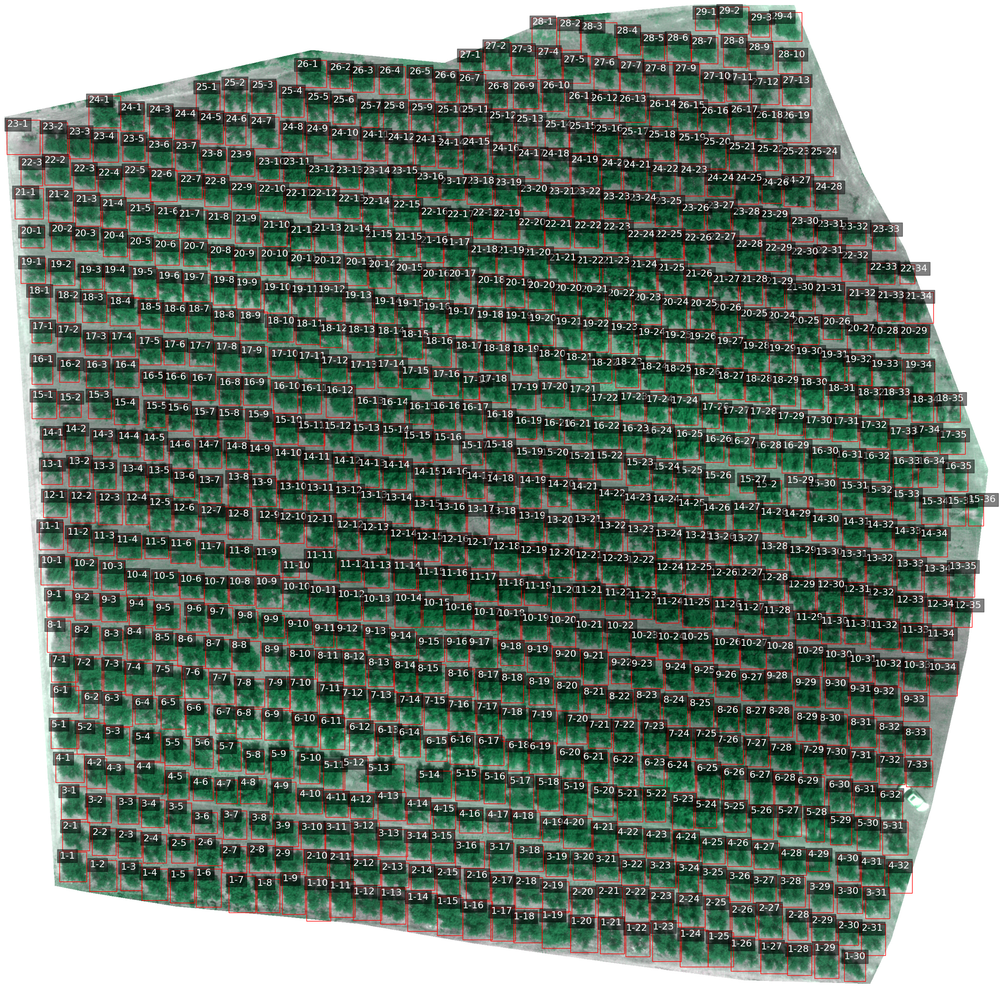

In [54]:
# Define file paths for both images and their respective JSON files
image_paths = [
    aerial_uav_images_file_paths["ndvi_rgb"],
    aerial_uav_images_file_paths["orthomosaic"]
]

json_paths = [
    f'{aerial_uav_dir}/tree_annotations.json',
    f'{date_dir}/Orchard_Mapping/Orthomosaic.json'
]

# Plot both images with annotations
for image_path, json_path in zip(image_paths, json_paths):
    plot_image_with_annotations(image_path, json_path)

In [55]:
# Load and inspect images
aerial_uav_images = {}
for name, path in aerial_uav_images_file_paths.items():
    image = Image.open(path)
    aerial_uav_images[name] = image

In [56]:
# Convert images to RGB if necessary
converted_aerial_uav_images = {}
for name, image in aerial_uav_images.items():
    # if image.mode != 'RGB':
    #     image = image.convert('RGB')
    converted_aerial_uav_images[name] = np.asarray(image)

##### Create csv file for location of trees

In [57]:
# Load the JSON file
with open(os.path.join(orchard_mapping_file_path, 'Orthomosaic.json')) as file:
    orthomosaic_json_annotation_data = json.load(file)

with open(os.path.join(aerial_uav_dir, 'tree_annotations.json')) as file:
    uav_json_annotation_data = json.load(file)

In [58]:
# Convert labels CSV to a dictionary for quick lookup
labels_dict = pd.Series(label_df['Label'].values, index=label_df['Tree_ID']).to_dict()

In [59]:
# Extract regions data from the new JSON file
new_orthomosaic_regions_data = orthomosaic_json_annotation_data['regions']
new_uav_regions_data = uav_json_annotation_data['regions']

In [60]:
# Calculate the dimensions of the grid based on the regions data
orthomosaic_max_x = max(region['points']['x'][1] for region in new_orthomosaic_regions_data)
orthomosaic_max_y = max(region['points']['y'][1] for region in new_orthomosaic_regions_data)

In [61]:
# Assuming a grid of 30x21 based on the previous labels
grid_width = 21
grid_height = 30

In [62]:
# Create a mapping of coordinates to names
name_mapping = {}
for y in range(grid_height):
    for x in range(grid_width):
        label = f"{grid_height - y}-{x + 1}"
        name_mapping[(x, y)] = label

In [63]:
# Function to normalize coordinates and map to names
def process_batch(regions_batch, vertical_shift=0):
    coordinates = [(region['points']['x'][0], region['points']['y'][0] + vertical_shift) for region in regions_batch]
    x_coords = [coord[0] for coord in coordinates]
    y_coords = [coord[1] for coord in coordinates]
    norm_x = np.interp(x_coords, (min(x_coords), max(x_coords)), (0, grid_width - 1)).astype(int)
    norm_y = np.interp(y_coords, (min(y_coords), max(y_coords)), (0, grid_height - 1)).astype(int)
    # names = [name_mapping[(x, y)] for x, y in zip(norm_x, norm_y)]
    rows = []
    for region in regions_batch: # for name, region in zip(names, regions_batch)
        label = labels_dict.get(name, '')  # Get label from dictionary
        row = [
            region['name'],
            region['class'],
            region['shape'],
            region['points']['x'][0],
            region['points']['x'][1],
            region['points']['y'][0] + vertical_shift,
            region['points']['y'][1] + vertical_shift,
            label  # Add label to the row
        ]
        rows.append(row)
    return rows

In [64]:
# Initialize a new CSV file with header
Orthomosaic_csv_output_path_with_names = os.path.join(orchard_mapping_file_path, 'Orthomosaic_converted_with_new_names_and_labels.csv')
with open(Orthomosaic_csv_output_path_with_names, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(['Tree_ID', 'class', 'shape', 'x1', 'x2', 'y1', 'y2', 'label'])

In [65]:
# Process and append data in smaller chunks for orthomosaic
batch_size = 50  # Adjust batch size if necessary
for i in range(0, len(new_orthomosaic_regions_data), batch_size):
    batch = new_orthomosaic_regions_data[i:i + batch_size]
    batch_rows = process_batch(batch)
    with open(Orthomosaic_csv_output_path_with_names, mode='a', newline='') as csv_file:
        csv_writer = csv.writer(csv_file)
        csv_writer.writerows(batch_rows)

In [66]:
# Initialize a new CSV file with header
uav_csv_output_path_with_names = os.path.join(aerial_uav_dir, 'uav_converted_with_new_names_and_labels.csv')
with open(uav_csv_output_path_with_names, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(['Tree_ID', 'class', 'shape', 'x1', 'x2', 'y1', 'y2', 'label'])

In [67]:
# Process and append data in smaller chunks for UAV annotations with a vertical shift
for i in range(0, len(new_uav_regions_data), batch_size):
    batch = new_uav_regions_data[i:i + batch_size]
    batch_rows = process_batch(batch)  # Adjust the shift value as needed
    with open(uav_csv_output_path_with_names, mode='a', newline='') as csv_file:
        csv_writer = csv.writer(csv_file)
        csv_writer.writerows(batch_rows)

##### Display csv file with location of trees in UAV files

In [68]:
# Load the CSV file with annotations
orthomosaic_csv_file_path = os.path.join(orchard_mapping_file_path, 'Orthomosaic_converted_with_new_names_and_labels.csv')
orthomosaic_annotations = pd.read_csv(orthomosaic_csv_file_path)


uav_csv_file_path = os.path.join(aerial_uav_dir, 'uav_converted_with_new_names_and_labels.csv')
uav_annotations = pd.read_csv(uav_csv_file_path)

In [69]:
# Define a function to add annotations to an image
def add_annotations(image_array, annotations, status_colors_rgb, thickness=4, vertical_shift=0):
    for index, row in annotations.iterrows():
        x1, x2, y1, y2 = int(row['x1']), int(row['x2']), int(row['y1']) + vertical_shift, int(row['y2']) + vertical_shift
        label = row['label']
        color = status_colors_rgb.get(label, (255, 255, 255))  # Default to white if label is not in label_colors
        cv2.rectangle(image_array, (x1, y1), (x2, y2), color, thickness)  # Draw rectangle with the corresponding color and thickness
    return image_array

In [70]:
# Add annotations to all images with a vertical shift for non-orthomosaic images
annotated_images = {}
for name, image in converted_aerial_uav_images.items():
    if name == 'orthomosaic':
        annotated_images[name] = add_annotations(image.copy(), orthomosaic_annotations, status_colors_rgb, thickness=4)
    else:
        annotated_images[name] = add_annotations(image.copy(), uav_annotations, status_colors_rgb, thickness=4)  # Adjust the shift value as needed

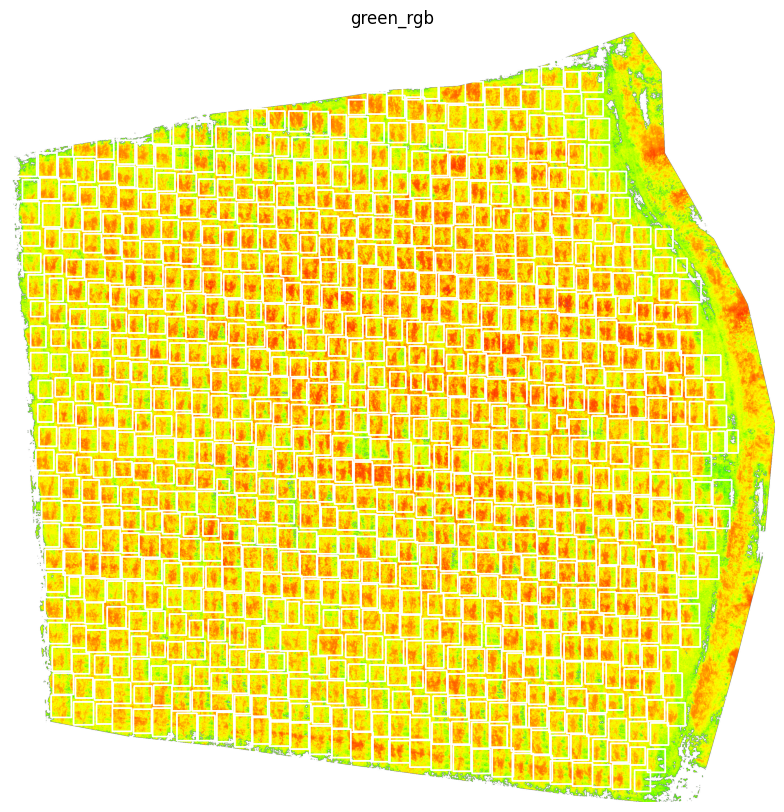

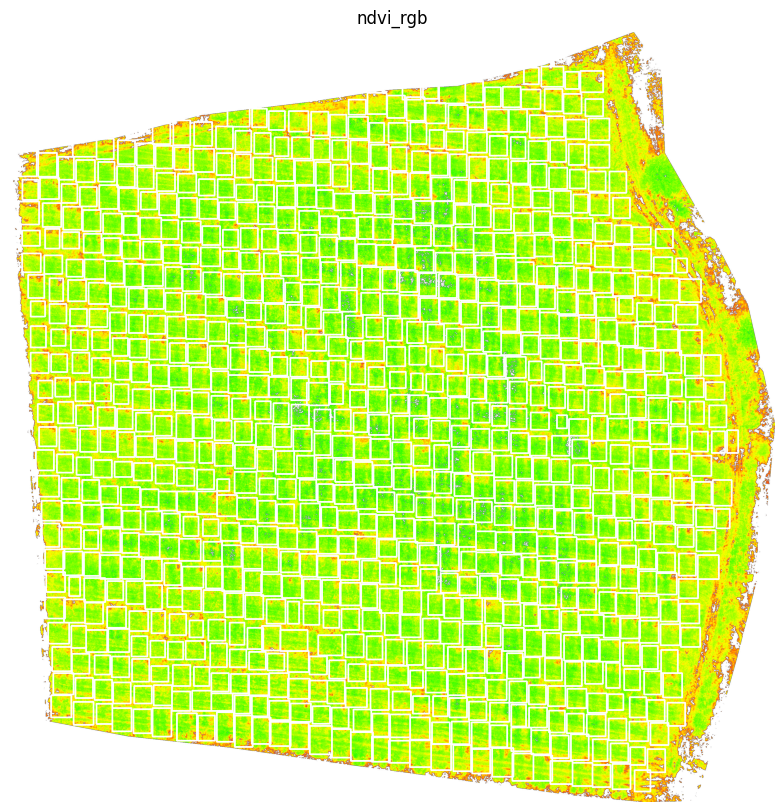

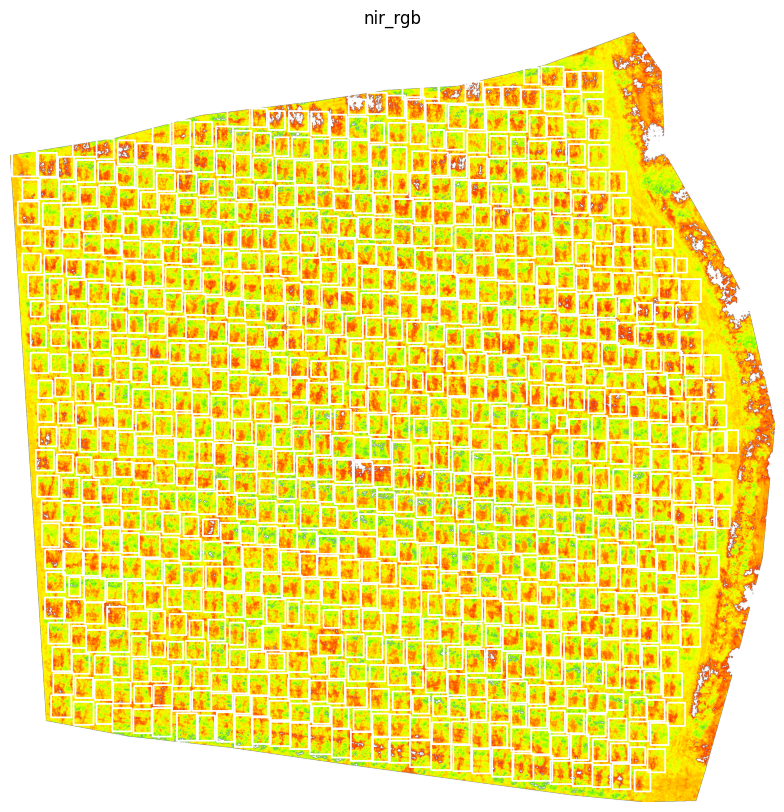

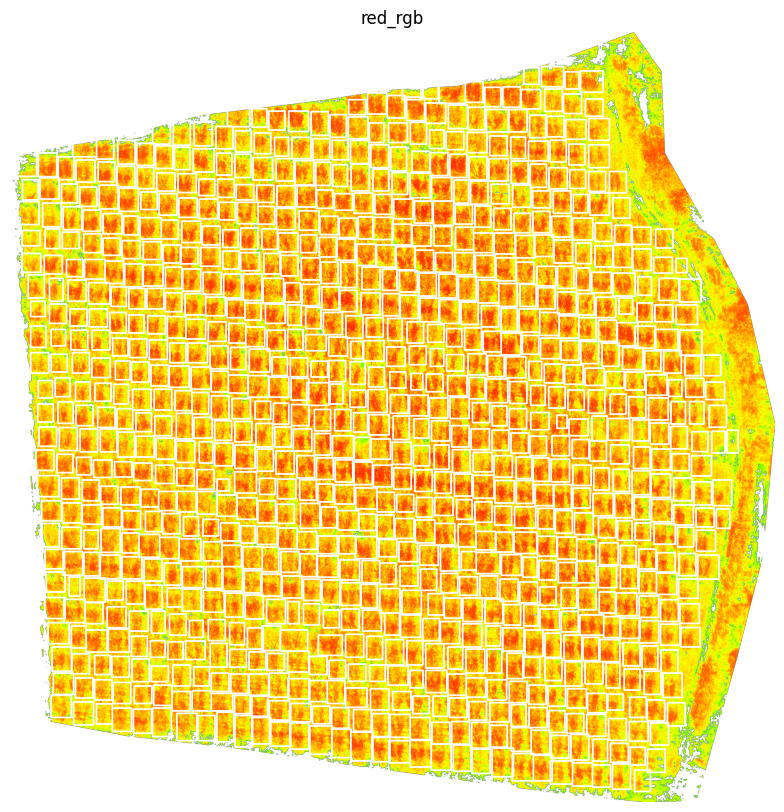

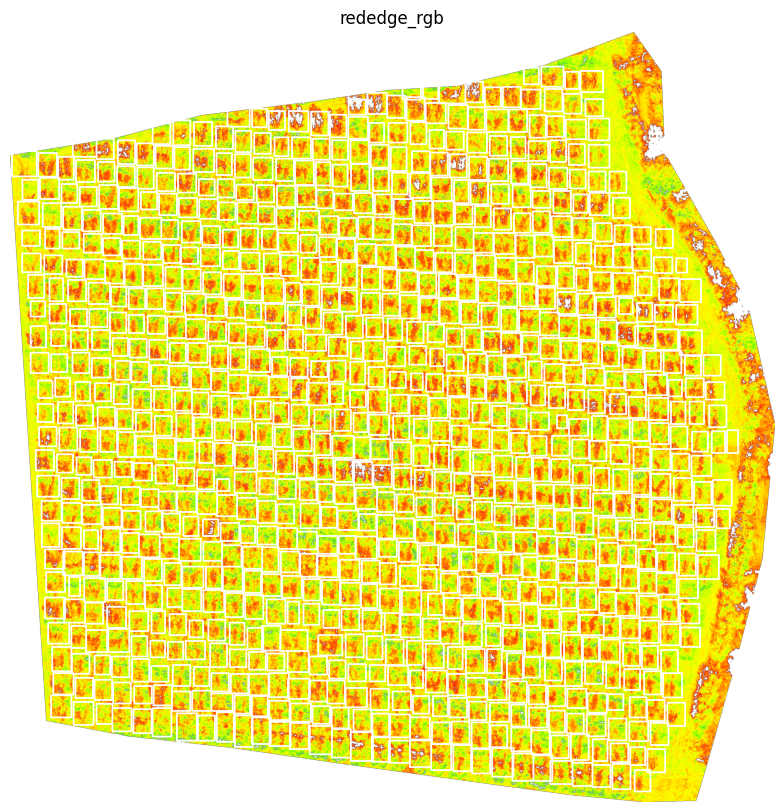

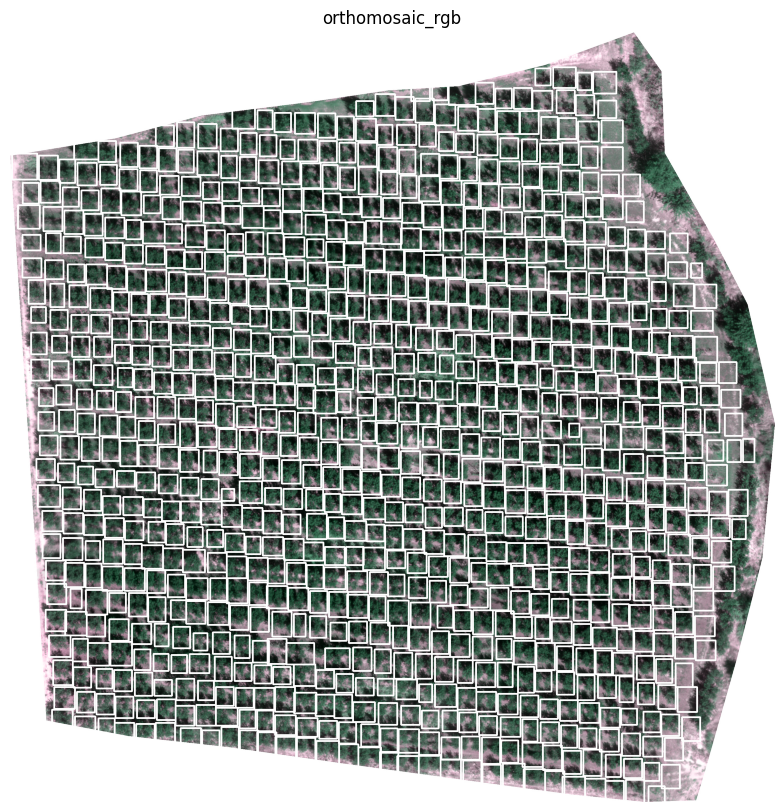

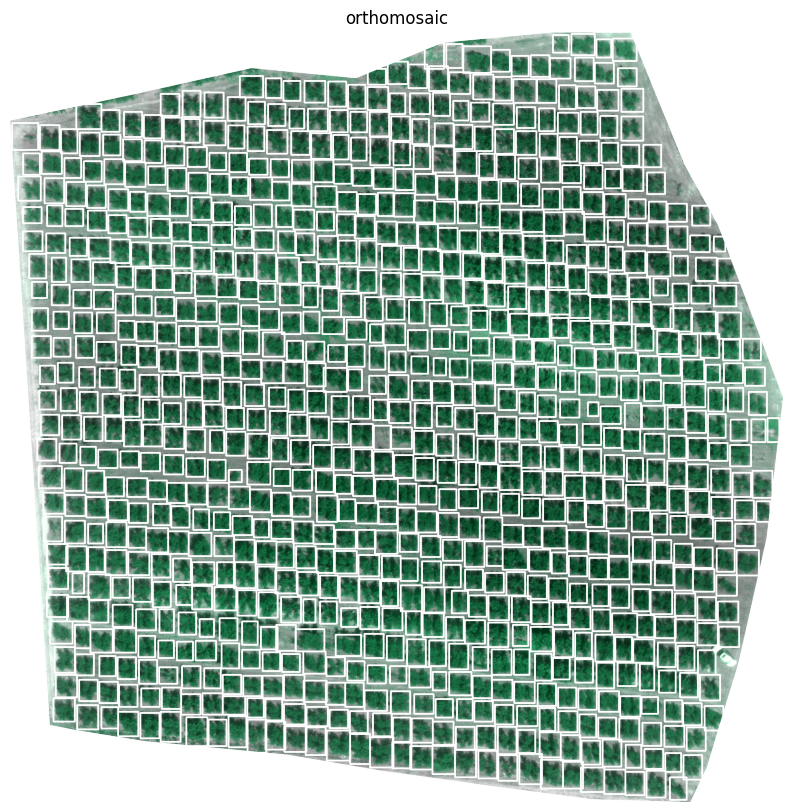

In [71]:
# Display the annotated images one after the other
for name, image in annotated_images.items():
    if 'rgb' in name or name == 'orthomosaic':
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.title(name)
        plt.axis('off')
        plt.show()

##### Save new annotations file

In [72]:
# Define a function to update the annotations with a vertical shift
def update_annotations(regions, vertical_shift=0, horizontal_shift=0):
    for region in regions:
        region['points']['y'] = [y + vertical_shift for y in region['points']['y']]
        region['points']['x'] = [x + horizontal_shift for x in region['points']['x']]
    return regions

In [73]:
# Extract regions data from the original JSON
regions = orthomosaic_json_annotation_data['regions']

In [74]:
# Apply a vertical shift to the annotations
shifted_regions = update_annotations(regions, vertical_shift=35, horizontal_shift = 0)  # Adjust the shift value as needed

In [75]:
# Update the JSON data with the shifted annotations
new_orthomosaic_json_annotation_data = orthomosaic_json_annotation_data.copy()
new_orthomosaic_json_annotation_data['regions'] = shifted_regions

In [76]:
# Save the new JSON data to a file
# new_json_annotation_path = os.path.join(aerial_uav_dir, 'tree_annotations.json')
# with open(new_json_annotation_path, 'w') as file:
#     json.dump(new_orthomosaic_json_annotation_data, file, indent=4)

# print(f"New JSON file with updated annotations saved to {new_json_annotation_path}")

### Step 7: Calculate the indices

In [77]:
# Process each row in the DataFrame
target_shape = (960, 1280)  # Define the target shape for resizing

In [78]:
# Function to load an image from a local file path and convert it to a numpy array
def load_image_from_path(path):
    img = Image.open(path)
    return np.asarray(img)

In [79]:
# Function to load and resize image
def process_image(image_path, target_shape, mode='L'):
    if not image_path or not os.path.exists(image_path):
        return None
    try:
        image = Image.open(image_path)
        # Print the mode
        # print(f"The mode of the image is: {image.mode}")

        # If the image is in 'I;16' mode, normalize it to 8-bit
        if image.mode == 'I;16':
            image_np = np.array(image)
            image_np_normalized = ((image_np - image_np.min()) / (image_np.max() - image_np.min()) * 255).astype(np.uint8)
            image = Image.fromarray(image_np_normalized)
        
        # Convert to the desired mode (e.g., 'L' for grayscale, 'RGB' for color)
        image = image.convert(mode)

        # Choose the appropriate resampling method based on the version of Pillow
        resampling_method = Image.Resampling.LANCZOS if hasattr(Image, 'Resampling') else Image.LANCZOS
        image = image.resize(target_shape, resampling_method)

        return image
    except Exception as e:
        print(f"Error processing image {image_path}: {e}")
        return None

In [80]:
# Function to normalize image array based on the provided maximum value
def normalize_image(image_array, max_value):
    """Normalize image array based on the provided maximum value."""
    if image_array is not None:
        return image_array / max_value
    else:
        return None

##### Compute the NDVI Image

In [81]:
# Load the annotation CSV file
annotations_csv_path = os.path.join(aerial_uav_dir, "uav_converted_with_new_names_and_labels.csv")
annotations = pd.read_csv(annotations_csv_path)

In [82]:
# Convert the images to numpy arrays
green = load_image_from_path(aerial_uav_images_file_paths["green_data"])
nir = load_image_from_path(aerial_uav_images_file_paths["nir_data"])
red = load_image_from_path(aerial_uav_images_file_paths["red_data"])
rededge = load_image_from_path(aerial_uav_images_file_paths["rededge_data"])

In [83]:
# Compute NDVI
ndvi = (nir - red) / (nir + red)

In [84]:
# Initialize lists to store index values and coordinates for each tree
tree_ndvi_values = []
tree_evi_values = []
tree_ndre_values = []
tree_savi_values = []
tree_gndvi_values = []
tree_rvi_values = []
tree_tvi_values = []

x1_list, x2_list, y1_list, y2_list = [], [], [], []

In [85]:
# Define the necessary constants for EVI and SAVI calculations
L = 0.5
C1 = 6
C2 = 7.5
G = 2.5

In [86]:
# Ensure no division by zero
epsilon = 1e-10

In [87]:
# Iterate over each annotation box to compute the indices
for index, row in annotations.iterrows():
    x1, x2, y1, y2 = int(row['x1']), int(row['x2']), int(row['y1']), int(row['y2'])
    
    # Extract the region for each tree
    tree_red = red[y1:y2, x1:x2]
    tree_nir = nir[y1:y2, x1:x2]
    tree_green = green[y1:y2, x1:x2]
    tree_rededge = rededge[y1:y2, x1:x2]
    
    # Compute the indices for each tree
    tree_ndvi = (tree_nir - tree_red) / (tree_nir + tree_red + epsilon)
    tree_evi = G * (tree_nir - tree_red) / (tree_nir + C1 * tree_red - C2 * tree_green + L + epsilon)
    tree_ndre = (tree_nir - tree_rededge) / (tree_nir + tree_rededge + epsilon)
    tree_savi = ((tree_nir - tree_red) * (1 + L)) / (tree_nir + tree_red + L + epsilon)
    tree_gndvi = (tree_nir - tree_green) / (tree_nir + tree_green + epsilon)
    tree_rvi = tree_nir / (tree_red + epsilon)
    tree_tvi = 0.5 * (120 * (tree_nir - tree_green) - 200 * (tree_red - tree_green))
    
    # Compute the average value of each index for the tree region
    tree_ndvi_values.append(np.mean(tree_ndvi))
    tree_evi_values.append(np.mean(tree_evi))
    tree_ndre_values.append(np.mean(tree_ndre))
    tree_savi_values.append(np.mean(tree_savi))
    tree_gndvi_values.append(np.mean(tree_gndvi))
    tree_rvi_values.append(np.mean(tree_rvi))
    tree_tvi_values.append(np.mean(tree_tvi))
    
    # Store the coordinates
    x1_list.append(x1)
    x2_list.append(x2)
    y1_list.append(y1)
    y2_list.append(y2)

In [88]:
# Add the computed values and coordinates to the annotations DataFrame
annotations['UAV_NDVI'] = tree_ndvi_values
annotations['UAV_EVI'] = tree_evi_values
annotations['UAV_NDRE'] = tree_ndre_values
annotations['UAV_SAVI'] = tree_savi_values
annotations['UAV_GNDVI'] = tree_gndvi_values
annotations['UAV_RVI'] = tree_rvi_values
annotations['UAV_TVI'] = tree_tvi_values
annotations['x1'] = x1_list
annotations['x2'] = x2_list
annotations['y1'] = y1_list
annotations['y2'] = y2_list

In [89]:
# Integrate index values and coordinates into the multimodal DataFrame
tree_ids = annotations['Tree_ID'].values

for idx, tree_id in enumerate(tree_ids):
    multimodal_df.at[idx, 'Tree_ID'] = tree_id
    multimodal_df.at[idx, 'UAV_NDVI'] = tree_ndvi_values[idx]
    multimodal_df.at[idx, 'UAV_EVI'] = tree_evi_values[idx]
    multimodal_df.at[idx, 'UAV_NDRE'] = tree_ndre_values[idx]
    multimodal_df.at[idx, 'UAV_SAVI'] = tree_savi_values[idx]
    multimodal_df.at[idx, 'UAV_GNDVI'] = tree_gndvi_values[idx]
    multimodal_df.at[idx, 'UAV_RVI'] = tree_rvi_values[idx]
    multimodal_df.at[idx, 'UAV_TVI'] = tree_tvi_values[idx]
    multimodal_df.at[idx, 'x1'] = x1_list[idx]
    multimodal_df.at[idx, 'x2'] = x2_list[idx]
    multimodal_df.at[idx, 'y1'] = y1_list[idx]
    multimodal_df.at[idx, 'y2'] = y2_list[idx]

In [90]:
# Apply color mapping for visualization
def apply_color_map(ndvi):
    colormap = np.zeros((ndvi.shape[0], ndvi.shape[1], 3), dtype=np.uint8)
    colormap[ndvi <= 0] = [0, 0, 0]
    colormap[(ndvi > 0) & (ndvi < 0.06)] = [255, 0, 0]
    colormap[(ndvi >= 0.06) & (ndvi < 0.12)] = [255, 32, 0]
    colormap[(ndvi >= 0.12) & (ndvi < 0.18)] = [255, 64, 0]
    colormap[(ndvi >= 0.18) & (ndvi < 0.24)] = [255, 96, 0]
    colormap[(ndvi >= 0.24) & (ndvi < 0.30)] = [255, 128, 0]
    colormap[(ndvi >= 0.30) & (ndvi < 0.36)] = [255, 160, 0]
    colormap[(ndvi >= 0.36) & (ndvi < 0.42)] = [255, 192, 0]
    colormap[(ndvi >= 0.42) & (ndvi < 0.48)] = [255, 224, 0]
    colormap[(ndvi >= 0.48) & (ndvi < 0.54)] = [255, 240, 0]
    colormap[(ndvi >= 0.54) & (ndvi < 0.60)] = [224, 255, 0]
    colormap[(ndvi >= 0.60) & (ndvi < 0.66)] = [192, 255, 0]
    colormap[(ndvi >= 0.66) & (ndvi < 0.72)] = [176, 255, 0]
    colormap[(ndvi >= 0.72) & (ndvi < 0.78)] = [160, 255, 0]
    colormap[(ndvi >= 0.78) & (ndvi < 0.84)] = [144, 255, 0]
    colormap[(ndvi >= 0.84) & (ndvi < 0.90)] = [64, 255, 0]
    colormap[ndvi >= 0.90] = [16, 255, 0]
    return colormap

In [91]:
# Apply the color map
colored_ndvi = apply_color_map(ndvi)
ndvi_image = Image.fromarray(colored_ndvi)
ndvi_image.save(os.path.join(aerial_uav_dir, "NDVI_RGB.png"))

##### Calculate indices for multispectral images

In [92]:
# Initialize lists to store the calculated indices
multispectral_ndvi_values = []
multispectral_evi_values = []
multispectral_ndre_values = []
multispectral_savi_values = []
multispectral_gndvi_values = []
multispectral_rvi_values = []
multispectral_tvi_values = []
valid_indices = []

In [93]:
# Define constants
G = 2.5
C1 = 6.0
C2 = 7.5
L_evi = 1.0
L_savi = 0.5

In [94]:
# Target shape for resizing
target_size = (960, 1280)

In [95]:
# Initialize lists to store results with None values
ndvi_image_paths = [None] * len(multimodal_df)
gndvi_image_paths = [None] * len(multimodal_df)
ndre_image_paths = [None] * len(multimodal_df)
savi_image_paths = [None] * len(multimodal_df)

In [96]:
# Initialize lists to store results with None values
multispectral_ndvi_values = [None] * len(multimodal_df)
multispectral_evi_values = [None] * len(multimodal_df)
multispectral_ndre_values = [None] * len(multimodal_df)
multispectral_savi_values = [None] * len(multimodal_df)
multispectral_gndvi_values = [None] * len(multimodal_df)
multispectral_rvi_values = [None] * len(multimodal_df)
multispectral_tvi_values = [None] * len(multimodal_df)

In [97]:
# Funtion to calculate vegetation indices
def calculate_indices(nir, red, reg, gre):
    """Calculate vegetation indices given NIR, RED, REG, and GRE bands."""
    # NDVI calculation
    ndvi = (nir - red) / (nir + red + 1e-5)
    
    # EVI calculation
    evi = 2.5 * (nir - red) / (nir + 6 * red - 7.5 * gre + 1 + 1e-5)
    
    # NDRE calculation
    ndre = (nir - reg) / (nir + reg + 1e-5)
    
    # SAVI calculation
    savi = (nir - red) * (1 + 0.5) / (nir + red + 0.5 + 1e-5)
    
    # GNDVI calculation
    gndvi = (nir - gre) / (nir + gre + 1e-5)
    
    # RVI calculation
    rvi = nir / (red + 1e-5)
    
    # TVI calculation
    tvi = np.sqrt((nir - red) / (nir + red + 1e-5) + 0.5)
    
    return ndvi, evi, ndre, savi, gndvi, rvi, tvi


In [98]:
# Function to display the image with annotations
def display(image, annotations, title):
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(image, cmap='gray')
    for index, row in annotations.iterrows():
        x1, x2, y1, y2 = int(row['x1']), int(row['x2']), int(row['y1']), int(row['y2'])
        label = row['label']
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        ax.text(x1, y1, label, fontsize=12, color='red', verticalalignment='top')
    ax.set_title(title)
    plt.axis('off')
    plt.show()

In [99]:
# Process each row in the DataFrame
for index, row in multimodal_df.iterrows():
    try:
        # Load and resize images
        nir_image = process_image(row['Multispectral_NIR_Image'], target_size, mode='L')
        red_image = process_image(row['Multispectral_RED_Image'], target_size, mode='L')
        reg_image = process_image(row['Multispectral_REG_Image'], target_size, mode='L')
        gre_image = process_image(row['Multispectral_GRE_Image'], target_size, mode='L')
        rgb_image = process_image(row['Multispectral_RGB_Image'], target_size, mode='RGB')

        # annotations = annotations[annotations['Tree_ID'] == row['Tree_ID']]

        # Display the images
        # display(rgb_image, annotations, f"Multispectral RGB Image {index}")
        # display(nir_image, annotations, f"Multispectral NIR Image {index}")
        # display(red_image, annotations, f"Multispectral RED Image {index}")
        # display(reg_image, annotations, f"Multispectral REG Image {index}")

        # Convert images to numpy arrays
        nir_array = np.array(nir_image).astype(float) if nir_image else None
        red_array = np.array(red_image).astype(float) if red_image else None
        reg_array = np.array(reg_image).astype(float) if reg_image else None
        gre_array = np.array(gre_image).astype(float) if gre_image else None
        rgb_array = np.array(rgb_image).astype(float) if rgb_image else None
        
        # Normalize images assuming 16-bit data
        # nir_array = normalize_image(nir_image, 65535)
        # red_array = normalize_image(red_image, 65535)
        # reg_array = normalize_image(reg_image, 65535)
        # gre_array = normalize_image(gre_image, 65535)
        
        # Extract the directory from the Multispectral_RGB_Image path
        base_dir = os.path.dirname(row['Multispectral_RGB_Image'])

        # Check if all necessary images are loaded
        if nir_array is not None and red_array is not None and reg_array is not None and gre_array is not None:
            # Calculate indices
            ndvi, evi, ndre, savi, gndvi, rvi, tvi = calculate_indices(nir_array, red_array, reg_array, gre_array)

            # Store mean values of the indices in the DataFrame
            multimodal_df.at[index, 'Multispectral_NDVI'] = np.mean(ndvi)
            multimodal_df.at[index, 'Multispectral_EVI'] = np.mean(evi)
            multimodal_df.at[index, 'Multispectral_NDRE'] = np.mean(ndre)
            multimodal_df.at[index, 'Multispectral_SAVI'] = np.mean(savi)
            multimodal_df.at[index, 'Multispectral_GNDVI'] = np.mean(gndvi)
            multimodal_df.at[index, 'Multispectral_RVI'] = np.mean(rvi)
            multimodal_df.at[index, 'Multispectral_TVI'] = np.mean(tvi)
            
            # Optionally, save the NDVI image
            ndvi_normalized = np.clip((ndvi + 1) / 2 * 255, 0, 255).astype(np.uint8)
            ndvi_image = Image.fromarray(ndvi_normalized)
            ndvi_image_path = os.path.join(base_dir, f"ndvi_image_{index}.jpeg")
            ndvi_image.save(ndvi_image_path)
            ndvi_image_paths[index] = ndvi_image_path

            # Optionally, save the NDRE image
            ndre_normalized = np.clip((ndre + 1) / 2 * 255, 0, 255).astype(np.uint8)
            ndre_image = Image.fromarray(ndre_normalized)
            ndre_image_path = os.path.join(base_dir, f"ndre_image_{index}.jpeg")
            ndre_image.save(ndre_image_path)
            ndre_image_paths[index] = ndre_image_path
            
            # Optionally, save the SAVI image
            savi_normalized = np.clip((savi + 1) / 2 * 255, 0, 255).astype(np.uint8)
            savi_image = Image.fromarray(savi_normalized)
            savi_image_path = os.path.join(base_dir, f"savi_image_{index}.jpeg")
            savi_image.save(savi_image_path)
            savi_image_paths[index] = savi_image_path
            
            # Optionally, save the GNDVI image
            gndvi_normalized = np.clip((gndvi + 1) / 2 * 255, 0, 255).astype(np.uint8)
            gndvi_image = Image.fromarray(gndvi_normalized)
            gndvi_image_path = os.path.join(base_dir, f"gndvi_image_{index}.jpeg")
            gndvi_image.save(gndvi_image_path)
            gndvi_image_paths[index] = gndvi_image_path
        else:
            # Assign NaN for missing data
            multimodal_df.at[index, 'Multispectral_NDVI'] = np.nan
            multimodal_df.at[index, 'Multispectral_EVI'] = np.nan
            multimodal_df.at[index, 'Multispectral_NDRE'] = np.nan
            multimodal_df.at[index, 'Multispectral_SAVI'] = np.nan
            multimodal_df.at[index, 'Multispectral_GNDVI'] = np.nan
            multimodal_df.at[index, 'Multispectral_RVI'] = np.nan
            multimodal_df.at[index, 'Multispectral_TVI'] = np.nan

    except Exception as e:
        print(f"Error processing row {index}: {e}")
        # Assign NaN values for rows with errors
        multimodal_df.at[index, 'Multispectral_NDVI'] = np.nan
        multimodal_df.at[index, 'Multispectral_EVI'] = np.nan
        multimodal_df.at[index, 'Multispectral_NDRE'] = np.nan
        multimodal_df.at[index, 'Multispectral_SAVI'] = np.nan
        multimodal_df.at[index, 'Multispectral_GNDVI'] = np.nan
        multimodal_df.at[index, 'Multispectral_RVI'] = np.nan
        multimodal_df.at[index, 'Multispectral_TVI'] = np.nan

/var/folders/qd/ds8njzhn1zv9q727vvvr8h0m0000gn/T/ipykernel_2181/1215953414.py:23: RuntimeWarning: invalid value encountered in sqrt
  tvi = np.sqrt((nir - red) / (nir + red + 1e-5) + 0.5)
/var/folders/qd/ds8njzhn1zv9q727vvvr8h0m0000gn/T/ipykernel_2181/1215953414.py:23: RuntimeWarning: invalid value encountered in sqrt
  tvi = np.sqrt((nir - red) / (nir + red + 1e-5) + 0.5)


Error processing row 458: expected str, bytes or os.PathLike object, not NoneType
Error processing row 739: expected str, bytes or os.PathLike object, not NoneType
Error processing row 865: expected str, bytes or os.PathLike object, not NoneType


In [100]:
# Add the image paths to the DataFrame
multimodal_df['Multispectral_NDVI_Image'] = ndvi_image_paths
multimodal_df['Multispectral_GNDVI_Image'] = gndvi_image_paths
multimodal_df['Multispectral_NDRE_Image'] = ndre_image_paths
multimodal_df['Multispectral_SAVI_Image'] = savi_image_paths

### Step Final: Save Multimodal Dataframe

In [101]:
# Display the DataFrame with the new indices
multimodal_df.head()

,Date,Tree_ID,Orchard_Mapping_Image,Aerial_UAV_Image,Ground_RGB_Image,Ground_RGB_Image_with_Bounding_Boxes,Ground_RGB_Image_Annotations,Multispectral_RGB_Image,Multispectral_REG_Image,Multispectral_RED_Image,...,Multispectral_EVI,Multispectral_NDRE,Multispectral_SAVI,Multispectral_GNDVI,Multispectral_RVI,Multispectral_TVI,Multispectral_NDVI_Image,Multispectral_GNDVI_Image,Multispectral_NDRE_Image,Multispectral_SAVI_Image
0,04_11_21,29-1,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,...,22577.943459,0.054946,0.578614,0.308877,798.861030,NaN,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...
1,04_11_21,29-2,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,...,17586.085040,0.098110,0.661596,0.420410,815.203405,NaN,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...
2,04_11_21,29-4,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,...,15404.069917,0.085527,0.585869,0.422484,361.728795,NaN,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...
3,04_11_21,29-3,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,...,18357.275121,0.059559,0.602647,0.414713,442.763371,NaN,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...
4,04_11_21,28-10,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,None,None,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,...,17311.114602,0.075293,0.628999,0.412634,789.667606,NaN,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...,/Users/izzymohamed/Desktop/Vision For Social G...


In [102]:
multimodal_df.columns

Index(['Date', 'Tree_ID', 'Orchard_Mapping_Image', 'Aerial_UAV_Image',
       'Ground_RGB_Image', 'Ground_RGB_Image_with_Bounding_Boxes',
       'Ground_RGB_Image_Annotations', 'Multispectral_RGB_Image',
       'Multispectral_REG_Image', 'Multispectral_RED_Image',
       'Multispectral_NIR_Image', 'Multispectral_GRE_Image',
       'Multispectral_RGB_Bounding_Box_Image',
       'Multispectral_RGB_Bounding_Box_Annotation', 'Label', 'UAV_NDVI',
       'UAV_EVI', 'UAV_NDRE', 'UAV_SAVI', 'UAV_GNDVI', 'UAV_RVI', 'UAV_TVI',
       'x1', 'x2', 'y1', 'y2', 'Multispectral_NDVI', 'Multispectral_EVI',
       'Multispectral_NDRE', 'Multispectral_SAVI', 'Multispectral_GNDVI',
       'Multispectral_RVI', 'Multispectral_TVI', 'Multispectral_NDVI_Image',
       'Multispectral_GNDVI_Image', 'Multispectral_NDRE_Image',
       'Multispectral_SAVI_Image'],
      dtype='object')

In [103]:
# Save the DataFrame with NDVI values
output_csv_path = os.path.join(date_dir, "multimodal_data.csv")
multimodal_df.to_csv(output_csv_path, index=False)